# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [41]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [42]:
from datetime import date
from datetime import datetime
import os
import pickle
import sys

import pandas as pd
import io
from contextlib import redirect_stdout
import re
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model

from keras.layers import Input, Dense, Flatten, Dropout, Conv2D
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools
from scripts import models

import gc
from tensorflow.keras import backend as K

## Open Data

In [43]:
resolution = 48

start_dates = ['2019-01-01']
end_dates = ['2020-01-01']
dates = [f'{sd}_{ed}' for sd,ed in zip(start_dates, end_dates)]

data_files = []
label_files = []
# for elem in os.listdir("C:/Users/raulp/Documents/Master/TFM/minig-detector-tfm/data/training_data/48_px"):
for elem in os.listdir("../data/training_data/48_px"):
    if "_labels.pkl" in elem:
        label_files.append(elem)
    elif ".pkl" in elem:
        data_files.append(elem)


patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
positive_patches = patches[labels == 1]
negative_patches = patches[labels == 0]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/15 [00:00<?, ?it/s]

2644 samples loaded
551 positive samples
2093 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

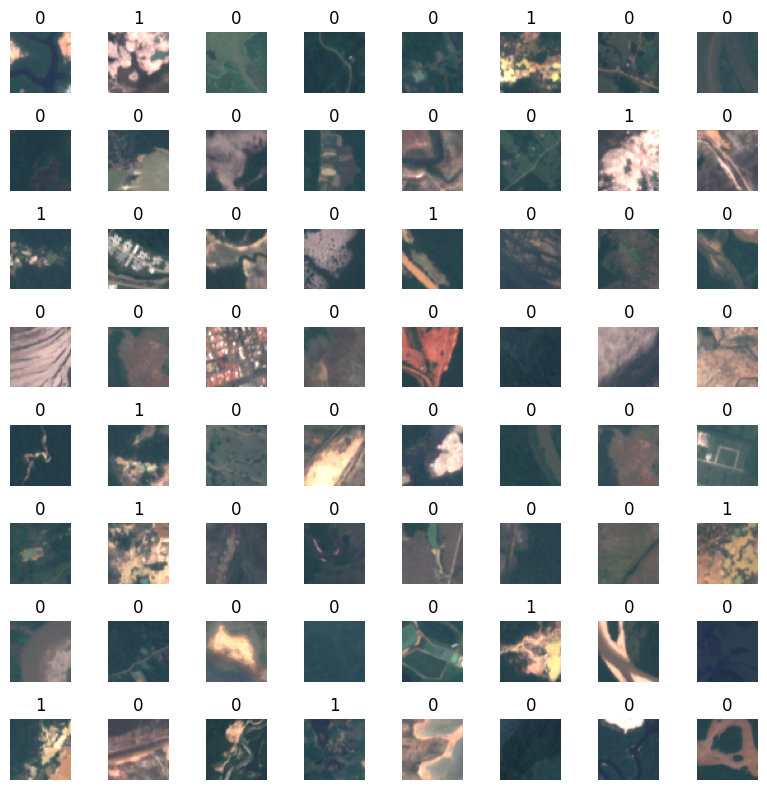

In [44]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [45]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.7546666666666666].


100.0% of data below brightness limit


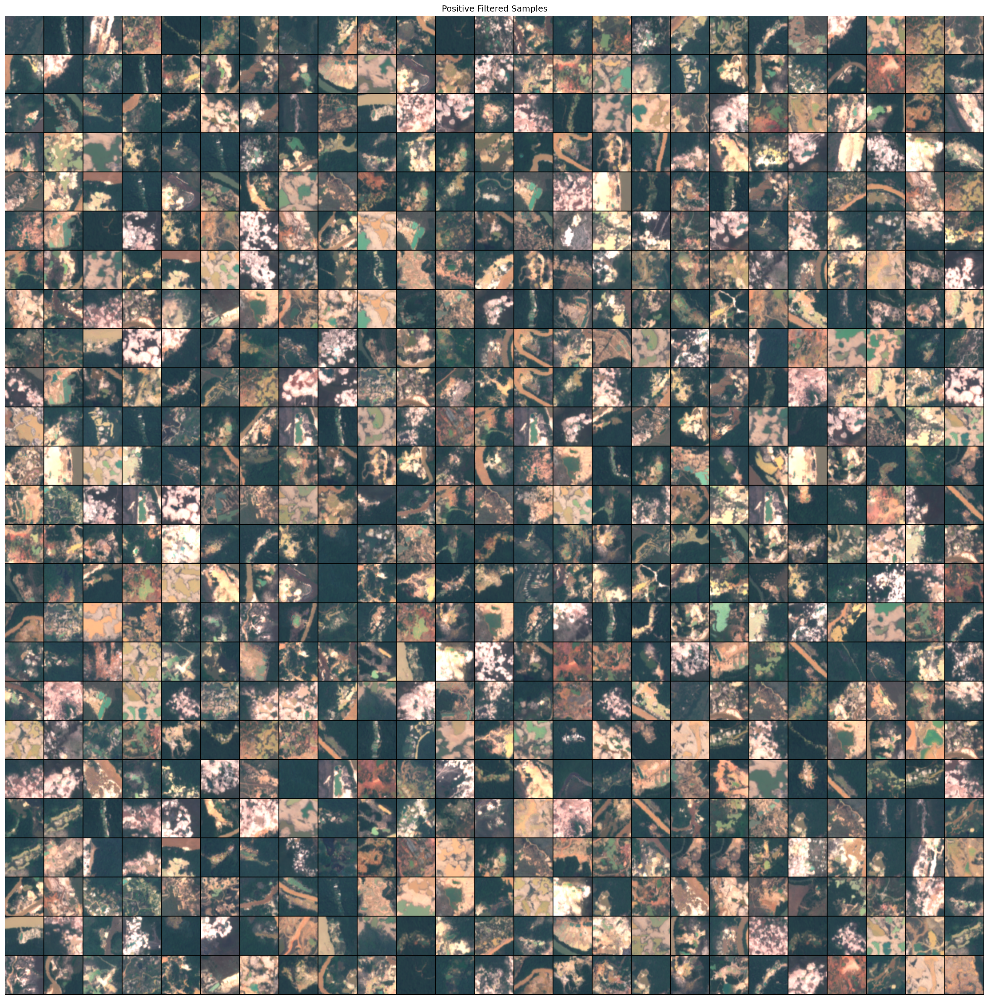

In [46]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..4.788666666666667].


100.0% of data below brightness limit


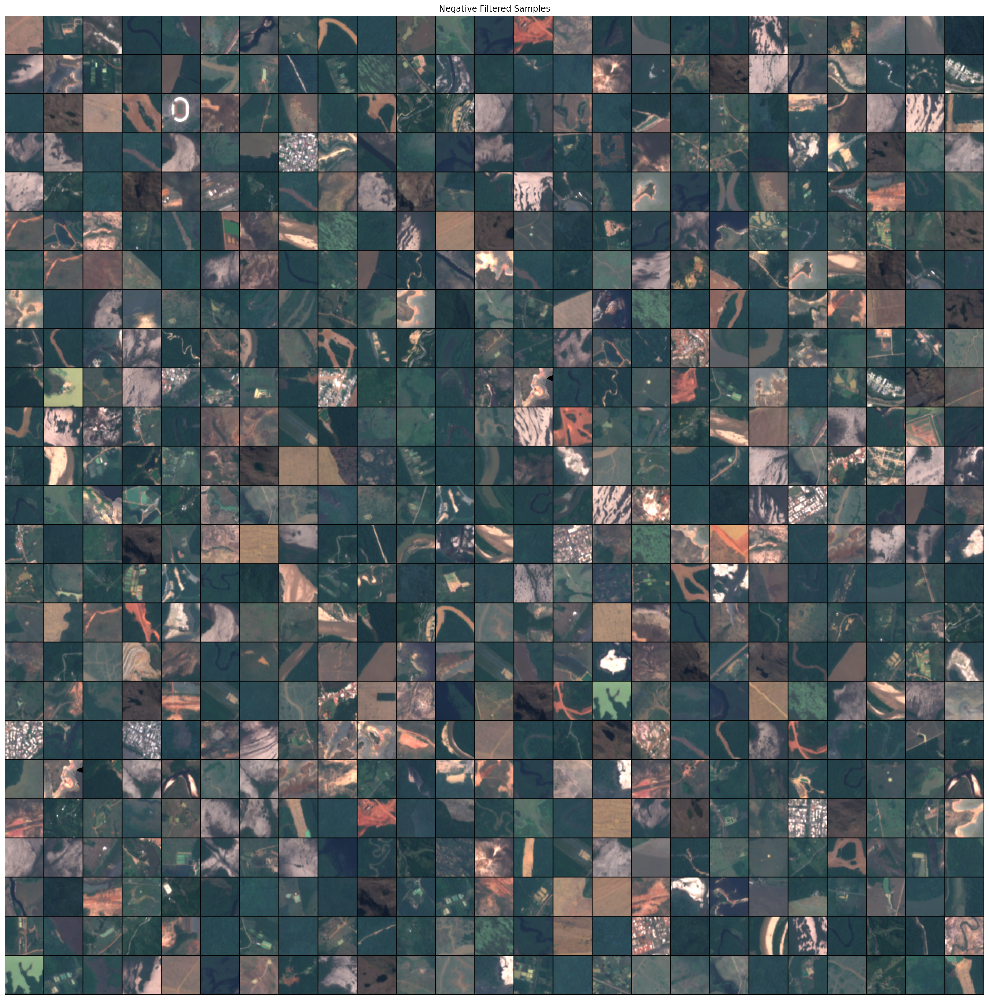

In [47]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [48]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

## Data Augmentation
Augmentation is important to help the model train. These are parameters that generally worked, but there is certainly room for improvement.

Plot a set of images to give an example of augmented images

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (2644, 48, 48, 12) (12 channels).
  warnings.warn(


  0%|          | 0/64 [00:00<?, ?it/s]

<Figure size 1800x1800 with 0 Axes>

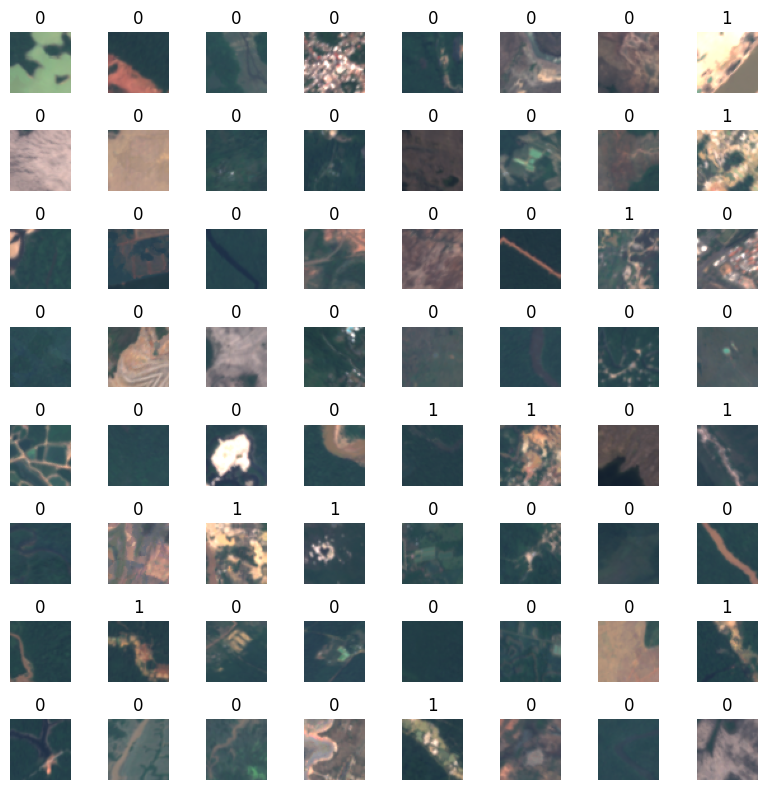

In [49]:
augmentation_parameters = {
    'featurewise_center': False,
    'rotation_range': 360,
    'width_shift_range': [0.9, 1.1],
    'height_shift_range': [0.9, 1.1],
    'shear_range': 10,
    'zoom_range': [0.9, 1.1],
    'vertical_flip': True,
    'horizontal_flip': True,
    # Fill options: "constant", "nearest", "reflect" or "wrap"
    'fill_mode': 'reflect'
}

datagen = ImageDataGenerator(**augmentation_parameters)


plt.figure(figsize=(12,12), facecolor=(1,1,1), dpi=150)
aug_img, aug_labels = datagen.flow(x, y, batch_size=64).next()
viz_tools.plot_image_grid(aug_img, labels=[int(l) for l in aug_labels], norm=True);


In [50]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

# Entrenamiento

## Balanceo de clases para el entrenamiento

In [51]:
# dataset_len = len(y)
# class_0 = len(y[y==0])
# class_1 = len(y[y==1])

# class_0_weighted = 2 - len(y[y==0]) / len(y)
# class_1_weighted = 2 - len(y[y==1]) / len(y)

# # add a weighted loss
# class_weighted = {0: class_0_weighted, 1: class_1_weighted}
# print(f"\nEl número de valores para la clase no mina es de {class_0} y para la clase mina {class_1}")
# print(f"\nPonemos peso a cada clase para tenerlo en cuenta en el entrenamiento {class_weighted}")

## Clases no balanceadas

In [52]:
# # add a weighted loss
# class_weight = {0: 1, 1: 1}

## Diccionario con todos los hiperparámetros editables

### Hiperparámetros para pruebas con test size del 20%

In [53]:
#########################################################################################################
########################################## CLASES BALANCEADAS ###########################################
#########################################################################################################
                                                                                                        #
# reduce_lr en callbacks                                                                                #                            
hiper_params_test1_20 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 15,                                                   #
                      "patience_reduce_lr" : 6,                                                         #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
                                                                                                        #
# SIN reduce_lr en callbacks                                                                            #
hiper_params_test2_20 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 15,                                                   #
                      "patience_reduce_lr" : 6,                                                         #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#########################################################################################################

#########################################################################################################
####################################### CLASES NO BALANCEADAS ###########################################
#########################################################################################################
                                                                                                        #
# Reduce_lr en callbacks                                                                                #
hiper_params_test3_20 = {"class_weight" : {0: 1, 1: 1},                                                 #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 15,                                                   #
                      "patience_reduce_lr" : 6,                                                         #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#SIN Reduce_lr en callbacks                                                                             #
hiper_params_test4_20 = {"class_weight" : {0: 1, 1: 1},                                                 #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 15,                                                   #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#########################################################################################################

### Hiperparámetros para pruebas con test size del 30%

In [54]:
#########################################################################################################
###################################### CLASES BALANCEADAS ###############################################
#########################################################################################################
                                                                                                        #
# Reduce_lr en callbacks                                                                                #
hiper_params_test1_30 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 16,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 15,                                                   #
                      "patience_reduce_lr" : 6,                                                         #
                      "test_size" : 0.3                                                                 #
                     }                                                                                  #         
                                                                                                        #
# SIN reduce_lr en callbacks                                                                            #   
hiper_params_test2_30 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 16,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 15,                                                   #
                      "patience_reduce_lr" : 6,                                                         #
                      "test_size" : 0.3                                                                 #
                     }                                                                                  #
#########################################################################################################

######################################################################################################
###################################### CLASES NO BALANCEADAS #########################################
######################################################################################################
                                                                                                     #
# Reduce_lr en callbacks                                                                             #  
hiper_params_test3_30 = {"class_weight" : {0: 1, 1: 1},                                              #
                      "batch_size" : 16,                                                             #
                      "epochs" : 160,                                                                #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],      #
                      "patience_early_stopping" : 15,                                                #
                      "patience_reduce_lr" : 6,                                                      #
                      "test_size" : 0.3                                                              #
                     }                                                                               #
                                                                                                     #
# SIN reduce_lr en callbacks                                                                         #      
hiper_params_test4_30 = {"class_weight" : {0: 1, 1: 1},                                              #
                      "batch_size" : 16,                                                             #
                      "epochs" : 160,                                                                #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                   #
                      "patience_early_stopping" : 15,                                                #
                      "test_size" : 0.3                                                              #
                     }                                                                               #
######################################################################################################

### Generamos una lista con todos los hiperparámetros definidos

In [55]:
hiperparametros_20 = [hiper_params_test1_20, hiper_params_test2_20, hiper_params_test3_20, hiper_params_test4_20]
hiperparametros_30 = [hiper_params_test1_30, hiper_params_test2_30, hiper_params_test3_30, hiper_params_test4_30]

## Realizamos el entrenamiento

En total se realizarán 8 ejecuciones con hiperparámetros distintos x 3 semillas distintas x 4 modelos = 96 modelos generados, 24 modelos generados por cada arquitectura empleada.

### Entrenamiento con split de 30 / 70 en test y training
3 semillas x 4 hiperparámetros distintos x 4 modelos = 48 modelos generados, 12 por cada arquitectura empleada

In [56]:
%%time

# Inicializamos para dar nombre a todos los outputs que se escriban
hora_exec = datetime.now().strftime('%Y-%m-%d_%H-%M')

# Creamos el nombre del directorio para guardar los modelos finales
path_prueba_actual = "../notebooks/best_models/split_30_"+hora_exec+"/"
os.makedirs(path_prueba_actual, exist_ok=True)

# Inicializamos las variables dónde almacenaremos los resultados de cada uno de los modelos generados
df_scratch = pd.DataFrame()
df_scratch_modified = pd.DataFrame()
df_vgg = pd.DataFrame()
df_mobile_net = pd.DataFrame()

#Eliminamos los csvs generados en ejecuciones anteriores
dl_utils.limpia_directorios("tabla_resultados")

# Eliminamos todos los modelos guardados de pruebas anteriores
# dl_utils.limpia_directorios("best_models")

# Recorremos la lista de configuraciones distinta generada anteriormente
for id_hiperparams,hiperparams in enumerate(hiperparametros_30):
    for semilla in range(0,3):  

        # Limpiamos la carpeta donde se guardan los modelos
        dl_utils.limpia_directorios("weigths")

        # Definimos hiperparámetros asociados a la ejecución actual
        batch_size = hiperparams["batch_size"]
        epochs = hiperparams["epochs"]
     
        # Dividimos el conjunto de imágenes en train y test
        seed = np.random.randint(0, 2000,1)[0]
        hiperparams["semilla"] = seed
        keras.utils.set_random_seed(int(seed))
        x_train, x_test, y_train, y_test = train_test_split(x_norm, y, test_size=hiperparams["test_size"], random_state=123)

        # Generamos los datagen de imágenes, empleamos las mismas imágenes en todos los modelos
        datagen.fit(x_train)
        train_generator = datagen.flow(x_train, y_train, batch_size=batch_size, shuffle=False)
        test_generator = datagen.flow(x_test, y_test, batch_size=batch_size, shuffle=False)
        
        # Definimos y compilamos los modelos
        scratch_original_model = models.scratch_original_model(x_train.shape[1:])
        scratch_modified_model = models.scratch_modified_model(x_train.shape[1:])
        vgg16 = models.vgg_16_model(x_train.shape[1:])
        mobile_net = models.mobilenet_model(x_train.shape[1:])

        # Modelo por defecto empleando los mismos parámetros que el original.
        scratch_original_model_results = scratch_original_model.fit(
            # datagen.flow(x_train, y_train),
            train_generator,
            batch_size=batch_size,
            epochs=epochs,
            validation_data=test_generator,
            # validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            class_weight={0: 1, 1: 1},
        )

        # Modelo from scratch modificado, ampliación del modelo original
        scratch_modified_model_results = scratch_modified_model.fit(
            # datagen.flow(x_train, y_train),
            train_generator,
            batch_size=batch_size,
            epochs=epochs,
            validation_data=test_generator,
            # validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            callbacks=dl_utils.define_callbacks("model_scratch_modified_",hiperparams),
            class_weight=hiperparams["class_weight"],
        )

        # Fine-tunning con los pesos del modelo VGG16
        vgg16_results = vgg16.fit(
            # datagen.flow(x_train, y_train),
            train_generator,
            batch_size=batch_size,
            epochs=epochs,
            validation_data=test_generator,
            # validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            callbacks=dl_utils.define_callbacks("model_vgg16_",hiperparams),
            class_weight=hiperparams["class_weight"],
        )

        # Fine-tunning con los pesos del modelo MobileNet
        mobile_net_results = mobile_net.fit(
            # datagen.flow(x_train, y_train),
            train_generator,
            batch_size=batch_size,
            epochs=epochs,
            validation_data=test_generator,
            # validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            callbacks=dl_utils.define_callbacks("model_mobilenet_",hiperparams),
            class_weight=hiperparams["class_weight"],
        )
    
        # Evaluamos el modelo y lo comparamos con el mejor almacenado.  
        hora_actual = datetime.now().strftime('%Y-%m-%d_%H-%M')
        df_scratch,          save_df_scratch          = dl_utils.get_df_best_model(scratch_original_model,x_test,y_test,"scratch_original_model_split_30_",df_scratch,hora_actual)
        df_scratch_modified, save_df_scratch_modified = dl_utils.get_df_best_model(scratch_modified_model,x_test,y_test,"scratch_modified_model_split_30_",df_scratch_modified,hora_actual)
        df_vgg,              save_df_vgg              = dl_utils.get_df_best_model(vgg16,x_test,y_test,"vgg16_split_30_",df_vgg,hora_actual)
        df_mobile_net,       save_df_mobile_net       = dl_utils.get_df_best_model(mobile_net,x_test,y_test,"mobile_net_split_30_",df_mobile_net,hora_actual)
    
        # Si el modelo actual es mejor que el almacenado, guardamos su información.      
        if save_df_scratch:
            best_scratch_model = scratch_original_model
            best_scratch_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_scratch_original_model_split_30_{hora_actual}.csv')
        
        if save_df_scratch_modified:
            best_scratch_modified_model = scratch_modified_model
            best_scratch_modified_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_scratch_modified_model_split_30_{hora_actual}.csv')
    
        if save_df_vgg:
            best_vgg_model = vgg16
            best_vgg_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_vgg16_split_30_{hora_actual}.csv')
    
        if save_df_mobile_net:
            best_mobile_net_model = mobile_net
            best_mobile_net_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_mobile_net_split_30_{hora_actual}.csv')

        del scratch_original_model
        del scratch_modified_model
        del vgg16
        del mobile_net
        del scratch_original_model_results
        del scratch_modified_model_results
        del vgg16_results
        del mobile_net_results
        del train_generator
        del test_generator
        K.clear_session()
        gc.collect()        

# Guardamos el mejor modelo empleando un split de 30%
dl_utils.save_models(best_scratch_model,best_scratch_hiperparams,hora_exec,f'scratch_original_model_split_30',path_prueba_actual)
dl_utils.save_models(best_scratch_modified_model,best_scratch_modified_hiperparams,hora_exec,f'scratch_modified_model_split_30',path_prueba_actual)
dl_utils.save_models(best_vgg_model,best_vgg_hiperparams,hora_exec,f'vgg16_split_30',path_prueba_actual)
dl_utils.save_models(best_mobile_net_model,best_mobile_net_hiperparams,hora_exec,f'mobile_net_split_30',path_prueba_actual)

# Guardamos los csv con los resultados de las métricas en los directorios finales
names_csv_best_params = [best_scratch_hiperparams[2],best_scratch_modified_hiperparams[2],best_vgg_hiperparams[2],best_mobile_net_hiperparams[2]]
dl_utils.obtener_tablas_resultado(path_prueba_actual,names_csv_best_params)

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:2093: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (1850, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1850, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axi

Epoch 1/160
116/116 [==============================] - 4s 19ms/step - loss: 0.5736 - acc: 0.7805 - val_loss: 0.5021 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.5085 - acc: 0.7897 - val_loss: 0.4301 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4847 - acc: 0.7897 - val_loss: 0.4094 - val_acc: 0.7922
Epoch 4/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4531 - acc: 0.7919 - val_loss: 0.3949 - val_acc: 0.8275
Epoch 5/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4214 - acc: 0.7968 - val_loss: 0.3702 - val_acc: 0.7947
Epoch 6/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4267 - acc: 0.7973 - val_loss: 0.3681 - val_acc: 0.7922
Epoch 7/160
116/116 [==============================] - 2s 20ms/step - loss: 0.3918 - acc: 0.8076 - val_loss: 0.3427 - val_acc: 0.8401
Epoch 8/160
116/116 [==============================] - 2s 19ms

2024-08-31 19:40:05.112709: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_5/dropout_23/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


114/116 [============================>.] - ETA: 0s - loss: 0.7959 - acc: 0.7860
Epoch 1: val_loss improved from inf to 0.51280, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 20ms/step - loss: 0.7910 - acc: 0.7881 - val_loss: 0.5128 - val_acc: 0.7922 - lr: 3.0000e-04
Epoch 2/160
114/116 [============================>.] - ETA: 0s - loss: 0.7122 - acc: 0.7915
Epoch 2: val_loss improved from 0.51280 to 0.37363, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 20ms/step - loss: 0.7055 - acc: 0.7946 - val_loss: 0.3736 - val_acc: 0.8501 - lr: 3.0000e-04
Epoch 3/160
114/116 [============================>.] - ETA: 0s - loss: 0.6167 - acc: 0.8047
Epoch 3: val_loss did not improve from 0.37363
116/116 [==============================] - 2s 19ms/step -

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:2093: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (1850, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1850, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axi

Epoch 1/160
116/116 [==============================] - 3s 18ms/step - loss: 0.5852 - acc: 0.7849 - val_loss: 0.5653 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.5166 - acc: 0.7914 - val_loss: 0.4925 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4648 - acc: 0.7930 - val_loss: 0.3892 - val_acc: 0.7922
Epoch 4/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4388 - acc: 0.7881 - val_loss: 0.3706 - val_acc: 0.7922
Epoch 5/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4115 - acc: 0.8011 - val_loss: 0.3649 - val_acc: 0.8035
Epoch 6/160
116/116 [==============================] - 2s 20ms/step - loss: 0.3996 - acc: 0.7989 - val_loss: 0.3567 - val_acc: 0.8489
Epoch 7/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4263 - acc: 0.7908 - val_loss: 0.4648 - val_acc: 0.8212
Epoch 8/160
116/116 [==============================] - 2s 19ms

2024-08-31 19:54:04.829763: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


113/116 [============================>.] - ETA: 0s - loss: 0.7913 - acc: 0.7908
Epoch 1: val_loss improved from inf to 0.53639, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 19ms/step - loss: 0.7956 - acc: 0.7892 - val_loss: 0.5364 - val_acc: 0.7922 - lr: 3.0000e-04
Epoch 2/160
114/116 [============================>.] - ETA: 0s - loss: 0.7225 - acc: 0.7860
Epoch 2: val_loss improved from 0.53639 to 0.47141, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 20ms/step - loss: 0.7237 - acc: 0.7854 - val_loss: 0.4714 - val_acc: 0.8350 - lr: 3.0000e-04
Epoch 3/160
114/116 [============================>.] - ETA: 0s - loss: 0.6216 - acc: 0.7932
Epoch 3: val_loss improved from 0.47141 to 0.36610, saving model to /mnt/c/Users/raulp/Documents/Master/

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
116/116 [==============================] - 3s 17ms/step - loss: 0.5934 - acc: 0.7681 - val_loss: 0.5071 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.5168 - acc: 0.7908 - val_loss: 0.4473 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4550 - acc: 0.8005 - val_loss: 0.4001 - val_acc: 0.8010
Epoch 4/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4386 - acc: 0.7908 - val_loss: 0.3678 - val_acc: 0.8149
Epoch 5/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4102 - acc: 0.8086 - val_loss: 0.3503 - val_acc: 0.8577
Epoch 6/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4040 - acc: 0.8135 - val_loss: 0.3500 - val_acc: 0.8539
Epoch 7/160
116/116 [==============================] - 2s 20ms/step - loss: 0.3826 - acc: 0.8124 - val_loss: 0.3315 - val_acc: 0.8715
Epoch 8/160
116/116 [==============================] - 2s 19ms

2024-08-31 20:08:54.762459: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


115/116 [============================>.] - ETA: 0s - loss: 0.7772 - acc: 0.7917
Epoch 1: val_loss improved from inf to 0.53608, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 19ms/step - loss: 0.7786 - acc: 0.7914 - val_loss: 0.5361 - val_acc: 0.7922 - lr: 3.0000e-04
Epoch 2/160
114/116 [============================>.] - ETA: 0s - loss: 0.6877 - acc: 0.7772
Epoch 2: val_loss improved from 0.53608 to 0.38587, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 20ms/step - loss: 0.6858 - acc: 0.7784 - val_loss: 0.3859 - val_acc: 0.8350 - lr: 3.0000e-04
Epoch 3/160
114/116 [============================>.] - ETA: 0s - loss: 0.5971 - acc: 0.8185
Epoch 3: val_loss improved from 0.38587 to 0.37080, saving model to /mnt/c/Users/raulp/Documents/Master/

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
116/116 [==============================] - 3s 17ms/step - loss: 0.5628 - acc: 0.7773 - val_loss: 0.4735 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.5182 - acc: 0.7903 - val_loss: 0.4359 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4780 - acc: 0.7973 - val_loss: 0.3713 - val_acc: 0.8174
Epoch 4/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4258 - acc: 0.8043 - val_loss: 0.3665 - val_acc: 0.8123
Epoch 5/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4209 - acc: 0.8000 - val_loss: 0.4270 - val_acc: 0.7960
Epoch 6/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4064 - acc: 0.8119 - val_loss: 0.3845 - val_acc: 0.8275
Epoch 7/160
116/116 [==============================] - 2s 19ms/step - loss: 0.3732 - acc: 0.8162 - val_loss: 0.3430 - val_acc: 0.8451
Epoch 8/160
116/116 [==============================] - 2s 19ms

2024-08-31 20:22:28.313950: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


114/116 [============================>.] - ETA: 0s - loss: 0.8006 - acc: 0.7871
Epoch 1: val_loss improved from inf to 0.64006, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 19ms/step - loss: 0.8018 - acc: 0.7870 - val_loss: 0.6401 - val_acc: 0.7922
Epoch 2/160
114/116 [============================>.] - ETA: 0s - loss: 0.8051 - acc: 0.7926
Epoch 2: val_loss improved from 0.64006 to 0.57963, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 19ms/step - loss: 0.8076 - acc: 0.7914 - val_loss: 0.5796 - val_acc: 0.7922
Epoch 3/160
113/116 [============================>.] - ETA: 0s - loss: 0.7813 - acc: 0.7913
Epoch 3: val_loss improved from 0.57963 to 0.49260, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/w

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
116/116 [==============================] - 3s 17ms/step - loss: 0.5784 - acc: 0.7822 - val_loss: 0.5008 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.5036 - acc: 0.7903 - val_loss: 0.4058 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4505 - acc: 0.8049 - val_loss: 0.3371 - val_acc: 0.8690
Epoch 4/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4306 - acc: 0.8189 - val_loss: 0.4118 - val_acc: 0.8086
Epoch 5/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4261 - acc: 0.8162 - val_loss: 0.3391 - val_acc: 0.8715
Epoch 6/160
116/116 [==============================] - 2s 19ms/step - loss: 0.3911 - acc: 0.8270 - val_loss: 0.4067 - val_acc: 0.8199
Epoch 7/160
116/116 [==============================] - 2s 19ms/step - loss: 0.3815 - acc: 0.8319 - val_loss: 0.3648 - val_acc: 0.8615
Epoch 8/160
116/116 [==============================] - 2s 19ms

2024-08-31 20:34:21.793711: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


116/116 [==============================] - ETA: 0s - loss: 0.8026 - acc: 0.7908
Epoch 1: val_loss improved from inf to 0.56172, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 18ms/step - loss: 0.8026 - acc: 0.7908 - val_loss: 0.5617 - val_acc: 0.7922
Epoch 2/160
113/116 [============================>.] - ETA: 0s - loss: 0.7146 - acc: 0.7814
Epoch 2: val_loss improved from 0.56172 to 0.43661, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 20ms/step - loss: 0.7179 - acc: 0.7805 - val_loss: 0.4366 - val_acc: 0.8048
Epoch 3/160
113/116 [============================>.] - ETA: 0s - loss: 0.6519 - acc: 0.7836
Epoch 3: val_loss improved from 0.43661 to 0.42338, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/w

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
116/116 [==============================] - 3s 17ms/step - loss: 0.5716 - acc: 0.7859 - val_loss: 0.5055 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.5076 - acc: 0.7908 - val_loss: 0.4586 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4745 - acc: 0.7892 - val_loss: 0.3901 - val_acc: 0.7922
Epoch 4/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4324 - acc: 0.7951 - val_loss: 0.3619 - val_acc: 0.8275
Epoch 5/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4199 - acc: 0.8049 - val_loss: 0.3474 - val_acc: 0.8514
Epoch 6/160
116/116 [==============================] - 2s 20ms/step - loss: 0.3903 - acc: 0.8254 - val_loss: 0.3615 - val_acc: 0.8602
Epoch 7/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4082 - acc: 0.8032 - val_loss: 0.3493 - val_acc: 0.8552
Epoch 8/160
116/116 [==============================] - 2s 19ms

2024-08-31 20:50:41.951776: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


113/116 [============================>.] - ETA: 0s - loss: 0.7958 - acc: 0.7930
Epoch 1: val_loss improved from inf to 0.55479, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 19ms/step - loss: 0.8003 - acc: 0.7914 - val_loss: 0.5548 - val_acc: 0.7922
Epoch 2/160
114/116 [============================>.] - ETA: 0s - loss: 0.7058 - acc: 0.7805
Epoch 2: val_loss did not improve from 0.55479
116/116 [==============================] - 2s 19ms/step - loss: 0.7075 - acc: 0.7811 - val_loss: 0.5777 - val_acc: 0.8174
Epoch 3/160
113/116 [============================>.] - ETA: 0s - loss: 0.6283 - acc: 0.8052
Epoch 3: val_loss improved from 0.55479 to 0.42841, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 20ms/step - loss: 0.6270 - acc: 0.8059 - val_

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
116/116 [==============================] - 3s 17ms/step - loss: 0.5715 - acc: 0.7870 - val_loss: 0.5024 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.5111 - acc: 0.7914 - val_loss: 0.4625 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4809 - acc: 0.7914 - val_loss: 0.4145 - val_acc: 0.7922
Epoch 4/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4431 - acc: 0.7930 - val_loss: 0.4586 - val_acc: 0.8010
Epoch 5/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4236 - acc: 0.8027 - val_loss: 0.4443 - val_acc: 0.7531
Epoch 6/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4069 - acc: 0.8146 - val_loss: 0.3612 - val_acc: 0.8463
Epoch 7/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4057 - acc: 0.7989 - val_loss: 0.3770 - val_acc: 0.8363
Epoch 8/160
116/116 [==============================] - 2s 19ms

2024-08-31 21:04:28.721253: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


116/116 [==============================] - ETA: 0s - loss: 0.5300 - acc: 0.7914
Epoch 1: val_loss improved from inf to 0.52622, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 19ms/step - loss: 0.5300 - acc: 0.7914 - val_loss: 0.5262 - val_acc: 0.7922 - lr: 3.0000e-04
Epoch 2/160
114/116 [============================>.] - ETA: 0s - loss: 0.4553 - acc: 0.7987
Epoch 2: val_loss improved from 0.52622 to 0.47375, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 20ms/step - loss: 0.4564 - acc: 0.7995 - val_loss: 0.4737 - val_acc: 0.8199 - lr: 3.0000e-04
Epoch 3/160
115/116 [============================>.] - ETA: 0s - loss: 0.4093 - acc: 0.8146
Epoch 3: val_loss improved from 0.47375 to 0.40534, saving model to /mnt/c/Users/raulp/Documents/Master/

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
116/116 [==============================] - 3s 17ms/step - loss: 0.5781 - acc: 0.7741 - val_loss: 0.4817 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4957 - acc: 0.7924 - val_loss: 0.5098 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4696 - acc: 0.8038 - val_loss: 0.3636 - val_acc: 0.8363
Epoch 4/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4481 - acc: 0.8054 - val_loss: 0.4131 - val_acc: 0.8086
Epoch 5/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4361 - acc: 0.7941 - val_loss: 0.3635 - val_acc: 0.8010
Epoch 6/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4167 - acc: 0.8011 - val_loss: 0.3702 - val_acc: 0.8413
Epoch 7/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4029 - acc: 0.8124 - val_loss: 0.4090 - val_acc: 0.8237
Epoch 8/160
116/116 [==============================] - 2s 20ms

2024-08-31 21:19:32.359235: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


116/116 [==============================] - ETA: 0s - loss: 0.5241 - acc: 0.7849
Epoch 1: val_loss improved from inf to 0.49554, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 19ms/step - loss: 0.5241 - acc: 0.7849 - val_loss: 0.4955 - val_acc: 0.7922 - lr: 3.0000e-04
Epoch 2/160
114/116 [============================>.] - ETA: 0s - loss: 0.4573 - acc: 0.7860
Epoch 2: val_loss improved from 0.49554 to 0.36897, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 20ms/step - loss: 0.4554 - acc: 0.7870 - val_loss: 0.3690 - val_acc: 0.8476 - lr: 3.0000e-04
Epoch 3/160
114/116 [============================>.] - ETA: 0s - loss: 0.4297 - acc: 0.8091
Epoch 3: val_loss did not improve from 0.36897
116/116 [==============================] - 2s 19ms/step -

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
116/116 [==============================] - 3s 17ms/step - loss: 0.5766 - acc: 0.7805 - val_loss: 0.4997 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.5261 - acc: 0.7914 - val_loss: 0.4796 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4829 - acc: 0.7962 - val_loss: 0.4796 - val_acc: 0.7997
Epoch 4/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4664 - acc: 0.7881 - val_loss: 0.4402 - val_acc: 0.7922
Epoch 5/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4261 - acc: 0.8065 - val_loss: 0.3468 - val_acc: 0.8602
Epoch 6/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4225 - acc: 0.8146 - val_loss: 0.3609 - val_acc: 0.8539
Epoch 7/160
116/116 [==============================] - 2s 20ms/step - loss: 0.3945 - acc: 0.8200 - val_loss: 0.3586 - val_acc: 0.8514
Epoch 8/160
116/116 [==============================] - 2s 19ms

2024-08-31 21:35:22.676020: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


115/116 [============================>.] - ETA: 0s - loss: 0.5258 - acc: 0.7890
Epoch 1: val_loss improved from inf to 0.51132, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 19ms/step - loss: 0.5259 - acc: 0.7886 - val_loss: 0.5113 - val_acc: 0.7922 - lr: 3.0000e-04
Epoch 2/160
113/116 [============================>.] - ETA: 0s - loss: 0.4737 - acc: 0.7875
Epoch 2: val_loss improved from 0.51132 to 0.42849, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 20ms/step - loss: 0.4686 - acc: 0.7897 - val_loss: 0.4285 - val_acc: 0.8060 - lr: 3.0000e-04
Epoch 3/160
113/116 [============================>.] - ETA: 0s - loss: 0.4196 - acc: 0.8047
Epoch 3: val_loss improved from 0.42849 to 0.40653, saving model to /mnt/c/Users/raulp/Documents/Master/

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
116/116 [==============================] - 3s 17ms/step - loss: 0.5780 - acc: 0.7849 - val_loss: 0.5047 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.5276 - acc: 0.7914 - val_loss: 0.5474 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4994 - acc: 0.7914 - val_loss: 0.4738 - val_acc: 0.7922
Epoch 4/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4385 - acc: 0.7935 - val_loss: 0.3650 - val_acc: 0.8186
Epoch 5/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4260 - acc: 0.7870 - val_loss: 0.3721 - val_acc: 0.7922
Epoch 6/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4103 - acc: 0.7962 - val_loss: 0.3697 - val_acc: 0.8401
Epoch 7/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4157 - acc: 0.8081 - val_loss: 0.3697 - val_acc: 0.8249
Epoch 8/160
116/116 [==============================] - 2s 20ms

2024-08-31 21:48:38.483024: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


116/116 [==============================] - ETA: 0s - loss: 0.5245 - acc: 0.7892
Epoch 1: val_loss improved from inf to 0.49529, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 18ms/step - loss: 0.5245 - acc: 0.7892 - val_loss: 0.4953 - val_acc: 0.7922
Epoch 2/160
113/116 [============================>.] - ETA: 0s - loss: 0.4462 - acc: 0.8019
Epoch 2: val_loss improved from 0.49529 to 0.41207, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 19ms/step - loss: 0.4485 - acc: 0.8011 - val_loss: 0.4121 - val_acc: 0.8287
Epoch 3/160
116/116 [==============================] - ETA: 0s - loss: 0.4038 - acc: 0.8119
Epoch 3: val_loss improved from 0.41207 to 0.39688, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/w

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
116/116 [==============================] - 3s 17ms/step - loss: 0.5664 - acc: 0.7719 - val_loss: 0.4986 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 19ms/step - loss: 0.5121 - acc: 0.7892 - val_loss: 0.4588 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4685 - acc: 0.8032 - val_loss: 0.3790 - val_acc: 0.8501
Epoch 4/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4262 - acc: 0.7984 - val_loss: 0.3679 - val_acc: 0.8010
Epoch 5/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4181 - acc: 0.8043 - val_loss: 0.3407 - val_acc: 0.8627
Epoch 6/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4564 - acc: 0.7881 - val_loss: 0.3813 - val_acc: 0.7922
Epoch 7/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4235 - acc: 0.8070 - val_loss: 0.3914 - val_acc: 0.8249
Epoch 8/160
116/116 [==============================] - 2s 19ms

2024-08-31 22:05:26.377345: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


116/116 [==============================] - ETA: 0s - loss: 0.5009 - acc: 0.7930
Epoch 1: val_loss improved from inf to 0.48912, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 18ms/step - loss: 0.5009 - acc: 0.7930 - val_loss: 0.4891 - val_acc: 0.7922
Epoch 2/160
114/116 [============================>.] - ETA: 0s - loss: 0.4484 - acc: 0.7954
Epoch 2: val_loss improved from 0.48912 to 0.39066, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 20ms/step - loss: 0.4454 - acc: 0.7968 - val_loss: 0.3907 - val_acc: 0.8589
Epoch 3/160
113/116 [============================>.] - ETA: 0s - loss: 0.4073 - acc: 0.8147
Epoch 3: val_loss did not improve from 0.39066
116/116 [==============================] - 2s 20ms/step - loss: 0.4071 - acc: 0.8173 - val_

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
116/116 [==============================] - 3s 17ms/step - loss: 0.5572 - acc: 0.7843 - val_loss: 0.5085 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - 2s 20ms/step - loss: 0.5047 - acc: 0.7870 - val_loss: 0.5610 - val_acc: 0.7922
Epoch 3/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4841 - acc: 0.7892 - val_loss: 0.4341 - val_acc: 0.7922
Epoch 4/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4643 - acc: 0.7924 - val_loss: 0.3905 - val_acc: 0.7947
Epoch 5/160
116/116 [==============================] - 2s 20ms/step - loss: 0.4329 - acc: 0.7870 - val_loss: 0.3713 - val_acc: 0.7922
Epoch 6/160
116/116 [==============================] - 2s 19ms/step - loss: 0.4225 - acc: 0.7924 - val_loss: 0.3560 - val_acc: 0.7997
Epoch 7/160
116/116 [==============================] - 2s 19ms/step - loss: 0.3976 - acc: 0.8097 - val_loss: 0.3559 - val_acc: 0.8123
Epoch 8/160
116/116 [==============================] - 2s 19ms

2024-08-31 22:20:30.689003: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


116/116 [==============================] - ETA: 0s - loss: 0.5100 - acc: 0.7886
Epoch 1: val_loss improved from inf to 0.53940, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 3s 19ms/step - loss: 0.5100 - acc: 0.7886 - val_loss: 0.5394 - val_acc: 0.7922
Epoch 2/160
116/116 [==============================] - ETA: 0s - loss: 0.4419 - acc: 0.7941
Epoch 2: val_loss improved from 0.53940 to 0.38622, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
116/116 [==============================] - 2s 19ms/step - loss: 0.4419 - acc: 0.7941 - val_loss: 0.3862 - val_acc: 0.7922
Epoch 3/160
114/116 [============================>.] - ETA: 0s - loss: 0.4024 - acc: 0.8190
Epoch 3: val_loss did not improve from 0.38622
116/116 [==============================] - 2s 19ms/step - loss: 0.4031 - acc: 0.8184 - val_

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:175: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[4][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:171: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

TypeError: can only concatenate str (not "list") to str

In [60]:
dl_utils.obtener_tablas_resultado(path_prueba_actual,names_csv_best_params)

FileNotFoundError: [Errno 2] No such file or directory: '../notebooks/tabla_resultados/resultados_evaluacion_scratch_modified_model_split_30_2024-08-31_21-29.csv'

In [57]:
print(df_scratch)
print(df_scratch_modified)
print(df_vgg)
print(df_mobile_net)

          index precision recall f1-score support
0           0.0      0.97   0.97     0.97     629
1           1.0      0.89   0.90     0.89     165
2      accuracy                      0.96     794
3     macro avg      0.93   0.93     0.93     794
4  weighted avg      0.96   0.96     0.96     794
          index precision recall f1-score support
0           0.0      0.99   0.97     0.98     629
1           1.0      0.90   0.95     0.92     165
2      accuracy                      0.97     794
3     macro avg      0.94   0.96     0.95     794
4  weighted avg      0.97   0.97     0.97     794
          index precision recall f1-score support
0           0.0      0.98   0.97     0.97     629
1           1.0      0.88   0.92     0.90     165
2      accuracy                      0.96     794
3     macro avg      0.93   0.94     0.93     794
4  weighted avg      0.96   0.96     0.96     794
          index precision recall f1-score support
0           0.0      0.97   0.97     0.97     629


In [58]:
print(best_scratch_hiperparams)
print(best_scratch_modified_hiperparams)
print(best_vgg_hiperparams)
print(best_mobile_net_hiperparams)

({'class_weight': {0: 1.2083963691376702, 1: 1.7916036308623298}, 'batch_size': 16, 'epochs': 160, 'define_callbacks': ['early_stopping', 'model_checkpoint'], 'patience_early_stopping': 15, 'patience_reduce_lr': 6, 'test_size': 0.3, 'semilla': 165}, 2, 'resultados_evaluacion_scratch_original_model_split_30_2024-08-31_20-28.csv')
({'class_weight': {0: 1, 1: 1}, 'batch_size': 16, 'epochs': 160, 'define_callbacks': ['reduce_lr', 'early_stopping', 'model_checkpoint'], 'patience_early_stopping': 15, 'patience_reduce_lr': 6, 'test_size': 0.3, 'semilla': 1493}, 3, 'resultados_evaluacion_scratch_modified_model_split_30_2024-08-31_21-29.csv')
({'class_weight': {0: 1.2083963691376702, 1: 1.7916036308623298}, 'batch_size': 16, 'epochs': 160, 'define_callbacks': ['reduce_lr', 'early_stopping', 'model_checkpoint'], 'patience_early_stopping': 15, 'patience_reduce_lr': 6, 'test_size': 0.3, 'semilla': 1128}, 1, 'resultados_evaluacion_vgg16_split_30_2024-08-31_20-02.csv')
({'class_weight': {0: 1.208396

### Entrenamiento con split de 20 / 80 en test y training

In [3]:
%%time

# Inicializamos para dar nombre a todos los outputs que se escriban
hora_exec = datetime.now().strftime('%Y-%m-%d_%H-%M')

# Creamos el nombre del directorio para guardar los modelos finales
path_prueba_actual = "../notebooks/best_models/split_20_"+hora_exec+"/"
os.makedirs(path_prueba_actual, exist_ok=True)

# Inicializamos las variables dónde almacenaremos los resultados de cada uno de los modelos generados
df_scratch = pd.DataFrame()
df_scratch_modified = pd.DataFrame()
df_vgg = pd.DataFrame()
df_mobile_net = pd.DataFrame()

#Eliminamos los csvs generados en ejecuciones anteriores
dl_utils.limpia_directorios("tabla_resultados")

# Eliminamos todos los modelos guardados de pruebas anteriores
# dl_utils.limpia_directorios("best_models")

# Recorremos la lista de configuraciones distinta generada anteriormente
for id_hiperparams,hiperparams in enumerate(hiperparametros_20):
    for semilla in range(0,3):  

        # Limpiamos la carpeta donde se guardan los modelos
        dl_utils.limpia_directorios("weigths")

        # Definimos hiperparámetros asociados a la ejecución actual
        batch_size = hiperparams["batch_size"]
        epochs = hiperparams["epochs"]
     
        # Dividimos el conjunto de imágenes en train y test
        seed = np.random.randint(0, 2000,1)[0]
        hiperparams["semilla"] = seed
        keras.utils.set_random_seed(int(seed))
        x_train, x_test, y_train, y_test = train_test_split(x_norm, y, test_size=hiperparams["test_size"], random_state=123)

        # Generamos los datagen de imágenes, empleamos las mismas imágenes en todos los modelos
        datagen.fit(x_train)
        train_generator = datagen.flow(x_train, y_train, batch_size=batch_size, shuffle=False)
        test_generator = datagen.flow(x_test, y_test, batch_size=batch_size, shuffle=False)
        
        # Definimos y compilamos los modelos
        scratch_original_model = models.scratch_original_model(x_train.shape[1:])
        scratch_modified_model = models.scratch_modified_model(x_train.shape[1:])
        vgg16 = models.vgg_16_model(x_train.shape[1:])
        mobile_net = models.mobilenet_model(x_train.shape[1:])

        # Modelo por defecto empleando los mismos parámetros que el original.
        scratch_original_model_results = scratch_original_model.fit(
            # datagen.flow(x_train, y_train),
            train_generator,
            batch_size=batch_size,
            epochs=epochs,
            validation_data=test_generator,
            # validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            class_weight={0: 1, 1: 1},
        )

        # Modelo from scratch modificado, ampliación del modelo original
        scratch_modified_model_results = scratch_modified_model.fit(
            # datagen.flow(x_train, y_train),
            train_generator,
            batch_size=batch_size,
            epochs=epochs,
            validation_data=test_generator,
            # validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            callbacks=dl_utils.define_callbacks("model_scratch_modified_",hiperparams),
            class_weight=hiperparams["class_weight"],
        )

        # Fine-tunning con los pesos del modelo VGG16
        vgg16_results = vgg16.fit(
            # datagen.flow(x_train, y_train),
            train_generator,
            batch_size=batch_size,
            epochs=epochs,
            validation_data=test_generator,
            # validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            callbacks=dl_utils.define_callbacks("model_vgg16_",hiperparams),
            class_weight=hiperparams["class_weight"],
        )

        # Fine-tunning con los pesos del modelo MobileNet
        mobile_net_results = mobile_net.fit(
            # datagen.flow(x_train, y_train),
            train_generator,
            batch_size=batch_size,
            epochs=epochs,
            validation_data=test_generator,
            # validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            callbacks=dl_utils.define_callbacks("model_mobilenet_",hiperparams),
            class_weight=hiperparams["class_weight"],
        )
    
        # Evaluamos el modelo y lo comparamos con el mejor almacenado.  
        hora_actual = datetime.now().strftime('%Y-%m-%d_%H-%M')
        df_scratch,          save_df_scratch          = dl_utils.get_df_best_model(scratch_original_model,x_test,y_test,"scratch_original_model_split_20_",df_scratch,hora_actual)
        df_scratch_modified, save_df_scratch_modified = dl_utils.get_df_best_model(scratch_modified_model,x_test,y_test,"scratch_modified_model_split_20_",df_scratch_modified,hora_actual)
        df_vgg,              save_df_vgg              = dl_utils.get_df_best_model(vgg16,x_test,y_test,"vgg16_split_20_",df_vgg,hora_actual)
        df_mobile_net,       save_df_mobile_net       = dl_utils.get_df_best_model(mobile_net,x_test,y_test,"mobile_net_split_20_",df_mobile_net,hora_actual)
    
        # Si el modelo actual es mejor que el almacenado, guardamos su información.      
        if save_df_scratch:
            best_scratch_model = scratch_original_model
            best_scratch_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_scratch_original_model_split_20_{hora_actual}.csv')
        
        if save_df_scratch_modified:
            best_scratch_modified_model = scratch_modified_model
            best_scratch_modified_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_scratch_modified_model_split_20_{hora_actual}.csv')
    
        if save_df_vgg:
            best_vgg_model = vgg16
            best_vgg_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_vgg16_split_20_{hora_actual}.csv')
    
        if save_df_mobile_net:
            best_mobile_net_model = mobile_net
            best_mobile_net_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_mobile_net_split_20_{hora_actual}.csv')

        del scratch_original_model
        del scratch_modified_model
        del vgg16
        del mobile_net
        del scratch_original_model_results
        del scratch_modified_model_results
        del vgg16_results
        del mobile_net_results
        del train_generator
        del test_generator
        K.clear_session()
        gc.collect()        

# Guardamos el mejor modelo empleando un split de 30%
dl_utils.save_models(best_scratch_model,best_scratch_hiperparams,hora_exec,f'scratch_original_model_split_20',path_prueba_actual)
dl_utils.save_models(best_scratch_modified_model,best_scratch_modified_hiperparams,hora_exec,f'scratch_modified_model_split_20',path_prueba_actual)
dl_utils.save_models(best_vgg_model,best_vgg_hiperparams,hora_exec,f'vgg16_split_20',path_prueba_actual)
dl_utils.save_models(best_mobile_net_model,best_mobile_net_hiperparams,hora_exec,f'mobile_net_split_20',path_prueba_actual)

# Guardamos los csv con los resultados de las métricas en los directorios finales
names_csv_best_params = [best_scratch_hiperparams[2],best_scratch_modified_hiperparams[2],best_vgg_hiperparams[2],best_mobile_net_hiperparams[2]]
dl_utils.obtener_tablas_resultado(path_prueba_actual,names_csv_best_params)

NameError: name 'dl_utils' is not defined

In [4]:
print(best_scratch_hiperparams)
print(best_scratch_modified_hiperparams)
print(best_vgg_hiperparams)
print(best_mobile_net_hiperparams)

NameError: name 'best_scratch_hiperparams' is not defined

In [ ]:
print(df_scratch)
print(df_scratch_modified)
print(df_vgg)
print(df_mobile_net)

# Evaluación del desempeño de los modelos:

In [ ]:
# dl_utils.evaluate_model(scratch_original_model,x_test,y_test,False,"scratch_original_model")
# dl_utils.grafica_accuracy(scratch_original_model_results,"scratch_original_model")

In [ ]:
# dl_utils.evaluate_model(scratch_modified_model,x_test,y_test,False,"scratch_modified_model")
# dl_utils.grafica_accuracy(scratch_modified_model_results,"scratch_modified_model")

In [ ]:
# dl_utils.evaluate_model(vgg16,x_test,y_test,False,"vgg16")
# dl_utils.grafica_accuracy(vgg16_results,"vgg16")

In [ ]:
# dl_utils.evaluate_model(mobile_net,x_test,y_test,False,"mobile_net")
# dl_utils.grafica_accuracy(mobile_net_results,"mobile_net")

# Evaluación conjunta

In [ ]:
# dl_utils.all_models_metrics([scratch_original_model_results,scratch_modified_model_results,vgg16_results,mobile_net_results],["scratch_original_model","scratch_modified_model","vgg16","mobile_net"])

In [ ]:
# dl_utils.evaluate_all_models([scratch_original_model,scratch_modified_model,vgg16,mobile_net],["scratch_original_model","scratch_modified_model","vgg16","mobile_net"],x_test,y_test)

# Exploración del número de parámetros entrenables

In [ ]:
def get_total_params(model):
    stream = io.StringIO()
    with redirect_stdout(stream):
        model.summary()
    summary_str = stream.getvalue()
    print(re.search(r"Total params.*\n.*\n.*",summary_str).group(0))

In [ ]:
get_total_params(models.scratch_original_model(x_train.shape[1:]))

In [ ]:
get_total_params(models.scratch_modified_model(x_train.shape[1:]))

In [ ]:
get_total_params(models.vgg_16_model(x_train.shape[1:]))

In [ ]:
get_total_params(models.mobilenet_model(x_train.shape[1:]))